In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import pathlib
import tensorflow as tf
import os
from os.path import isfile
from keras.models import load_model
import pandas as pd
import numpy as np
from keras.preprocessing import image
from keras.preprocessing.image import ImageDataGenerator
from keras import backend as K
import matplotlib.pyplot as plt
import cv2

Using TensorFlow backend.


In [3]:
os.environ["CUDA_VISIBLE_DEVICES"] = "0"
gpu_options = tf.GPUOptions(allow_growth=True)
sess = tf.Session(config=tf.ConfigProto(gpu_options=gpu_options))

In [4]:
def newSoftmax(x, axis=-1):
    ndim = K.ndim(x)
    if ndim >= 2:
        e = K.exp(x - K.max(x, axis=axis, keepdims=True))
        s = K.sum(e, axis=axis, keepdims=True)
        return e / s
    else:
        raise ValueError('Cannot apply softmax to a tensor that is 1D. '
                         'Received input: %s' % x)

In [5]:
model = load_model(str(pathlib.Path.cwd()) + "/models/" + "resnet50_keras_stage_2_group_NewSoftmax.h5",
                  custom_objects={'newSoftmax': newSoftmax})
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 224, 224, 3)  0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, 112, 112, 64) 256         conv1[0][0]                      
__________________________________________________________________________________________________
activation

In [6]:
def get_test_for_keras(input_csv):
    original_data = pd.read_csv(input_csv)
    df_test_for_keras = original_data[['relative_path', 'label']]
    df_test_for_keras = df_test_for_keras.astype(str)
    return df_test_for_keras

df_test_for_keras = get_test_for_keras(str(pathlib.Path.cwd()) + "/temp/" + "test_group.csv")
print(df_test_for_keras[:5])

directory = str(pathlib.Path.cwd()) + "/raw_datasets/images/plantVillage/"

                                       relative_path label
0       Peach___Bacterial_spot/Rutg._Bact.S 1180.JPG    16
1          Potato___Early_blight/RS_Early.B 8300.JPG    20
2   Grape___Esca_(Black_Measles)/FAM_B.Msls 4481.JPG    12
3   Grape___Esca_(Black_Measles)/FAM_B.Msls 4454.JPG    12
4  Tomato___Spider_mites Two-spotted_spider_mite/...    33


In [7]:
test_datagen = ImageDataGenerator(rescale=1./255)
test_generator = test_datagen.flow_from_dataframe(df_test_for_keras,
                                                  directory=directory,
                                                  x_col='relative_path',
                                                  y_col='label',
                                                  target_size=(224, 224),
                                                  batch_size=1,
                                                  shuffle=False,
                                                  drop_duplicates=False)
pred_test = model.predict_generator(test_generator, steps=len(test_generator))

Found 10937 images belonging to 38 classes.


In [8]:
model.evaluate_generator(test_generator, steps=len(test_generator))

[0.05466920483451848, 0.9890280698546219]

In [9]:
print(test_generator.class_indices)

{'0': 0, '1': 1, '10': 2, '11': 3, '12': 4, '13': 5, '14': 6, '15': 7, '16': 8, '17': 9, '18': 10, '19': 11, '2': 12, '20': 13, '21': 14, '22': 15, '23': 16, '24': 17, '25': 18, '26': 19, '27': 20, '28': 21, '29': 22, '3': 23, '30': 24, '31': 25, '32': 26, '33': 27, '34': 28, '35': 29, '36': 30, '37': 31, '4': 32, '5': 33, '6': 34, '7': 35, '8': 36, '9': 37}


In [10]:
label_actual_keras = dict((v, k) for k, v in test_generator.class_indices.items())

In [11]:
if isfile(str(pathlib.Path.cwd()) + "/temp/" + "class.txt"):
    with open(str(pathlib.Path.cwd()) + "/temp/" + "class.txt", 'rt') as f:
        labels = f.read().split('\n')[:-1]
print(labels)

['Apple___Apple_scab', 'Apple___Black_rot', 'Apple___Cedar_apple_rust', 'Apple___healthy', 'Blueberry___healthy', 'Cherry_(including_sour)___Powdery_mildew', 'Cherry_(including_sour)___healthy', 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot', 'Corn_(maize)___Common_rust_', 'Corn_(maize)___Northern_Leaf_Blight', 'Corn_(maize)___healthy', 'Grape___Black_rot', 'Grape___Esca_(Black_Measles)', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Grape___healthy', 'Orange___Haunglongbing_(Citrus_greening)', 'Peach___Bacterial_spot', 'Peach___healthy', 'Pepper,_bell___Bacterial_spot', 'Pepper,_bell___healthy', 'Potato___Early_blight', 'Potato___Late_blight', 'Potato___healthy', 'Raspberry___healthy', 'Soybean___healthy', 'Squash___Powdery_mildew', 'Strawberry___Leaf_scorch', 'Strawberry___healthy', 'Tomato___Bacterial_spot', 'Tomato___Early_blight', 'Tomato___Late_blight', 'Tomato___Leaf_Mold', 'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Tomato___Target_Sp

In [15]:
def show_max_activation_pos(img_tensor, model, pred_label_keras, pred_class, actual_class):
    fig, ax = plt.subplots(1, 3, figsize=(12, 4))
    ax = ax.flatten()
    ax[0].axis('off')
    ax[0].set_title(actual_class)
    ax[0].imshow(img_tensor[0])
    
    img_output = model.output[:, pred_label_keras]
    last_conv_layer = model.get_layer('activation_49')
    grads = K.gradients(img_output, last_conv_layer.output)[0]

    iterate = K.function([model.input], [grads[0], last_conv_layer.output[0]])
    grads_value, conv_layer_output_value = iterate([img_tensor])

    pooled_grads = np.mean(grads_value, axis=(0, 1))

    heatmap = np.dot(conv_layer_output_value, pooled_grads)
    heatmap = np.maximum(heatmap, 0)
    if np.max(heatmap) != 0:
        heatmap /= np.max(heatmap)
    ax1 = ax[1].matshow(heatmap, cmap=plt.cm.jet)
    fig.colorbar(ax1, ax=ax[1], cmap=plt.cm.jet)
    
    original_img = cv2.imread(img_path)
    heatmap = cv2.resize(heatmap, (original_img.shape[1], original_img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed_img = heatmap * 0.4 + original_img
    superimposed_img_for_plt = superimposed_img[:,:,::-1]
    superimposed_img_for_plt /= 255.
    superimposed_img_for_plt = np.clip(superimposed_img_for_plt, 0, 1)
    ax[2].axis('off')
    ax[2].set_title(pred_class)
    ax[2].imshow(superimposed_img_for_plt)
    
    plt.show()

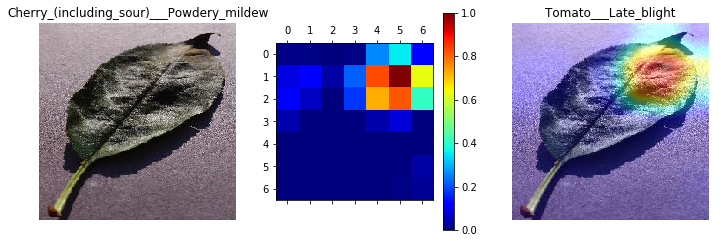

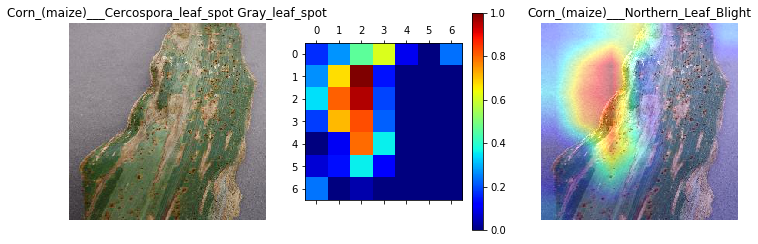

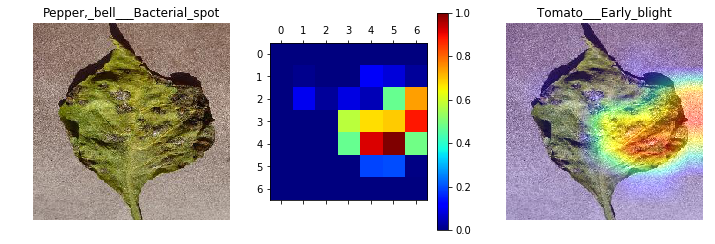

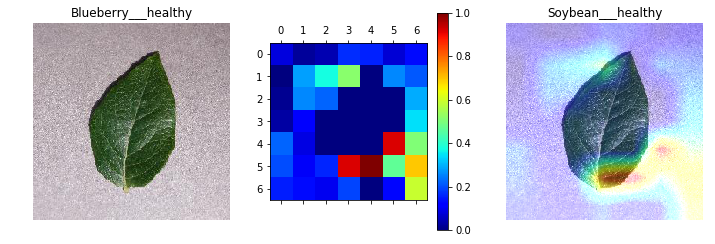

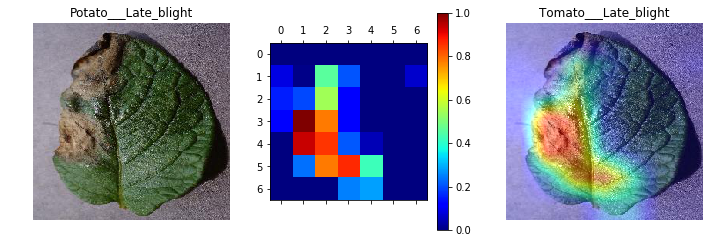

...

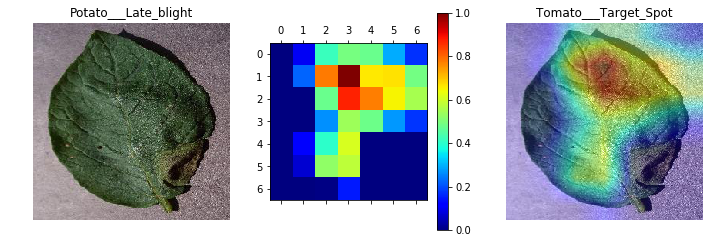

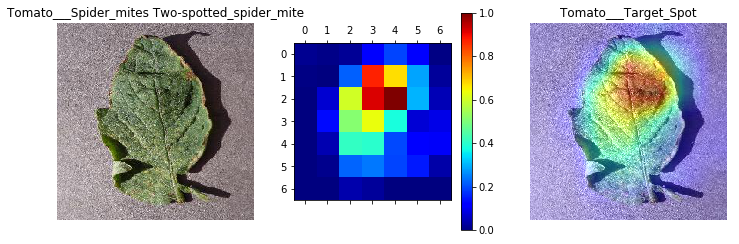

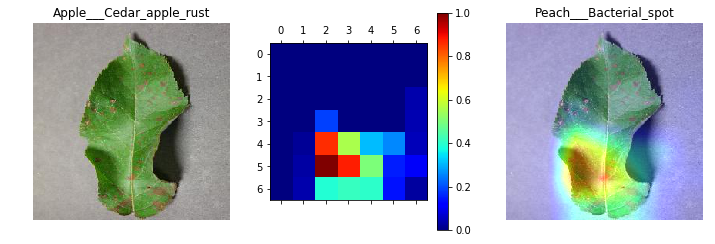

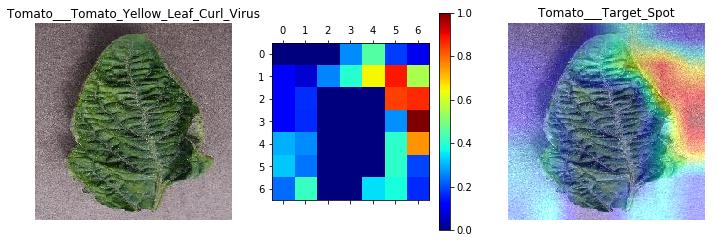

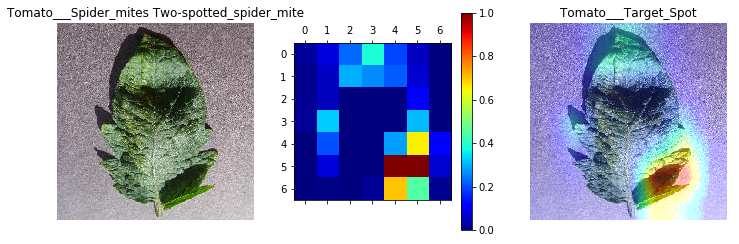

In [16]:
for index, row in df_test_for_keras.iterrows():
    img_path = directory + row['relative_path']
    actual_label = int(row['label'])
    
    img = image.load_img(img_path, target_size=(224, 224))
    img_tensor = image.img_to_array(img)
    img_tensor = np.expand_dims(img_tensor, axis=0)
    img_tensor /= 255.
    
    preds = model.predict(img_tensor)
    pred_label_keras = int(np.argmax(preds, axis=1))
    pred_label = int(label_actual_keras[pred_label_keras])
    if pred_label != actual_label:
        pred_class = labels[pred_label]
        actual_class = labels[actual_label]
        show_max_activation_pos(img_tensor, model, pred_label_keras, pred_class, actual_class)

In [63]:
def show_layer_activation(img_tensor, model, pred_label_keras):
    img_output = model.output[:, pred_label_keras]
    last_conv_layer = model.get_layer('activation_49')
    last_conv_layer_weights,last_conv_layer_bias= model.get_layer('dense_1').get_weights()
    grads = K.gradients(img_output, last_conv_layer.output)[0]
    
    iterate = K.function([model.input], [grads[0], last_conv_layer.output[0]])
    grads_value, conv_layer_output_value = iterate([img_tensor])
    
    conv_layer_output_value_max = conv_layer_output_value.max()
    conv_layer_output_value_min = conv_layer_output_value.min()
    conv_layer_output_value_mean = conv_layer_output_value.mean()
    conv_layer_output_value_median = np.median(conv_layer_output_value)
    print("conv_layer_output_value_max = " + str(conv_layer_output_value_max))
    print(np.where(conv_layer_output_value==conv_layer_output_value_max))
    print("conv_layer_output_value_min = " + str(conv_layer_output_value_min))
    print("conv_layer_output_value_mean = " + str(conv_layer_output_value_mean))
    print("conv_layer_output_value_median = " + str(conv_layer_output_value_median))
    
    print(conv_layer_output_value[:, :, 1698])
    print(last_conv_layer_weights[1698, :])
    print(grads_value[:, :, 1698])

    pooled_grads = np.mean(grads_value, axis=(0, 1))
      
    
    fig1 = plt.figure()
    ax1 = fig1.add_subplot(1, 1, 1)
    heatmap = np.dot(conv_layer_output_value, pooled_grads)
    heatmap = np.maximum(heatmap, 0)
    if np.max(heatmap) != 0:
        heatmap /= np.max(heatmap)
    ax1_handle = ax1.matshow(heatmap, cmap=plt.cm.jet)
    fig1.colorbar(ax1_handle, ax=ax1, cmap=plt.cm.jet)
    
    """
    grads_mat = pooled_grads.reshape(pooled_grads.shape[0]//16, 16)
    fig = plt.figure(figsize=(15, 15))
    ax = fig.add_subplot(1, 1, 1)
    ax_handle = ax.matshow(grads_mat, cmap=plt.cm.jet)
    fig.colorbar(ax_handle, ax=ax, cmap=plt.cm.jet)
    
    images_per_row = 16
    n_features = conv_layer_output_value.shape[-1]
    size = conv_layer_output_value.shape[0]
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = conv_layer_output_value[:, :, col * images_per_row + row]
            #channel_image = grads_value[:, :, col * images_per_row + row]
            channel_image -= channel_image.mean()
            if channel_image.std() != 0:
                channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size, row * size : (row + 1) * size] = channel_image
    scale = 1./size
    fig2 = plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
    ax2 = fig2.add_subplot(1, 1, 1)
    ax2.set_title('block5_conv3')
    ax2.grid(False)
    ax2.imshow(display_grid, aspect='auto', cmap=plt.cm.jet)
   # ax2.matshow(display_grid, aspect='auto', cmap=plt.cm.jet)
    plt.show(fig2) """

[[2.30954571e-16 8.15372907e-17 3.19660985e-14 1.70662011e-16
  5.49042248e-18 5.10995834e-15 8.64975646e-16 1.00000000e+00
  4.99071008e-15 1.09168485e-16 6.49348586e-16 2.63183775e-14
  4.93203992e-15 2.67142518e-16 6.41871615e-16 1.90637947e-16
  5.52745346e-17 7.81036314e-13 6.85783391e-16 4.04772197e-17
  9.00211582e-16 5.72292517e-15 3.29868167e-16 8.20478295e-15
  3.30739159e-14 3.13541058e-17 1.35683762e-15 8.42000883e-16
  4.62882171e-16 6.77233931e-13 9.95556638e-19 9.74212505e-14
  2.34105507e-14 2.02310828e-16 2.34407102e-14 3.90479563e-15
  4.24290238e-15 1.01974322e-14]]
conv_layer_output_value_max = 23.702652
(array([5]), array([3]), array([1698]))
conv_layer_output_value_min = 0.0
conv_layer_output_value_mean = 0.35644835
conv_layer_output_value_median = 0.0
[[ 0.         0.         0.         0.         0.         0.
   0.       ]
 [ 0.         0.         0.         3.3514729  1.7456585  0.
   0.       ]
 [ 0.         0.         6.223699   7.4109735  8.42962    4.92948

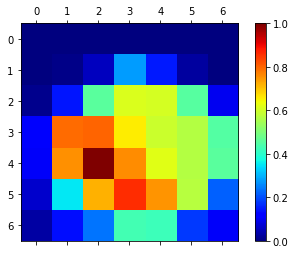

In [64]:
#img_path = directory + "Peach___Bacterial_spot/Rutg._Bact.S 1180.JPG"
img_path = directory + "Orange___Haunglongbing_(Citrus_greening)/UF.Citrus_HLB_Lab 0228.JPG"

img = image.load_img(img_path, target_size=(224, 224))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
img_tensor /= 255.

preds = model.predict(img_tensor)
print(preds)
pred_label_keras = int(np.argmax(preds, axis=1))
show_layer_activation(img_tensor, model, pred_label_keras)